In [1]:
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as mpl
import seaborn as sb
pd.set_option('display.max_columns',None)

In [2]:
warnings.filterwarnings("ignore")

In [3]:
df = pd.read_csv('//media/minato/Local Disk/My Stuff/Data Science/basic_projects/MLOPS-proj/experiments/Bank Customer Churn Prediction.csv')
df.head()

,customer_id,credit_score,country,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn
0,15634602,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,15647311,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,15619304,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,15701354,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,15737888,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [4]:
df.tail()

,customer_id,credit_score,country,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn
9995,15606229,771,France,Male,39,5,0.00,2,1,0,96270.64,0
9996,15569892,516,France,Male,35,10,57369.61,1,1,1,101699.77,0
9997,15584532,709,France,Female,36,7,0.00,1,0,1,42085.58,1
9998,15682355,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1
9999,15628319,792,France,Female,28,4,130142.79,1,1,0,38190.78,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customer_id       10000 non-null  int64  
 1   credit_score      10000 non-null  int64  
 2   country           10000 non-null  object 
 3   gender            10000 non-null  object 
 4   age               10000 non-null  int64  
 5   tenure            10000 non-null  int64  
 6   balance           10000 non-null  float64
 7   products_number   10000 non-null  int64  
 8   credit_card       10000 non-null  int64  
 9   active_member     10000 non-null  int64  
 10  estimated_salary  10000 non-null  float64
 11  churn             10000 non-null  int64  
dtypes: float64(2), int64(8), object(2)
memory usage: 937.6+ KB


In [6]:
df.shape

(10000, 12)

In [7]:
df.isnull().sum()

customer_id         0
credit_score        0
country             0
gender              0
age                 0
tenure              0
balance             0
products_number     0
credit_card         0
active_member       0
estimated_salary    0
churn               0
dtype: int64

In [8]:
df.duplicated().sum()

np.int64(0)

In [9]:
df = df.drop(['customer_id','country',],axis = 1)

In [10]:
df.shape

(10000, 10)

In [11]:
df['churn'].value_counts()

churn
0    7963
1    2037
Name: count, dtype: int64

In [12]:
(df['churn'].value_counts()[1]/df.shape[0])*100

np.float64(20.369999999999997)

In [13]:
(df['churn'].value_counts()[0]/df.shape[0])*100

np.float64(79.63)

<Axes: xlabel='gender', ylabel='count'>

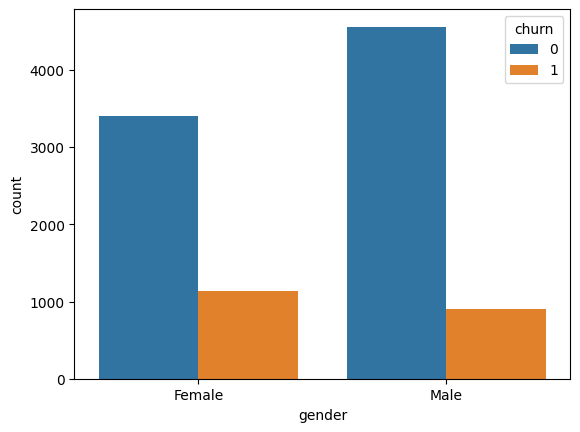

In [14]:
sb.countplot(x = 'gender',data = df,hue = 'churn')

Column: credit_score


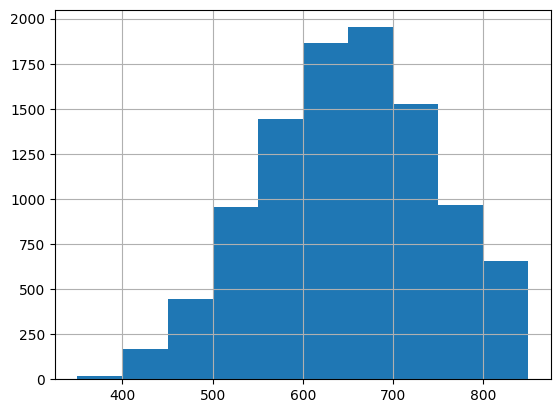

Column: gender


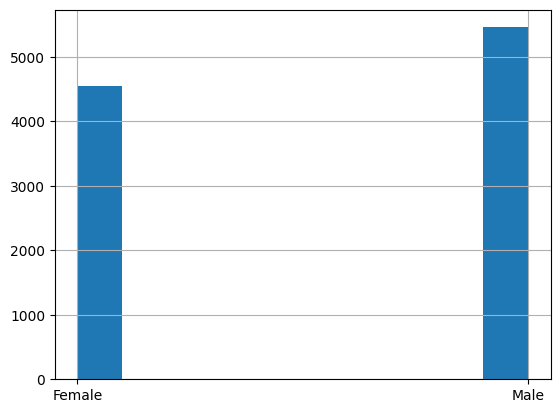

Column: age


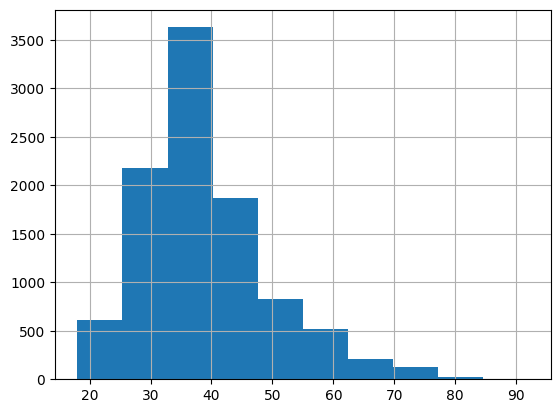

Column: tenure


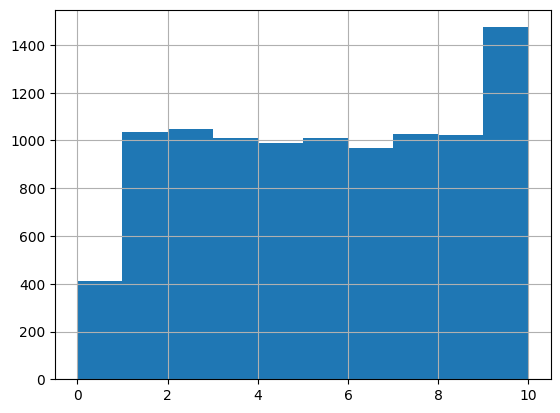

Column: balance


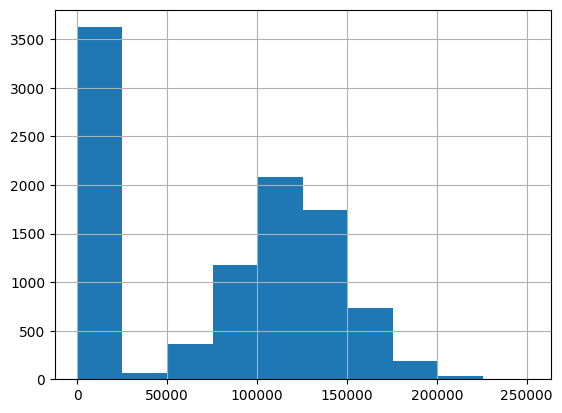

Column: products_number


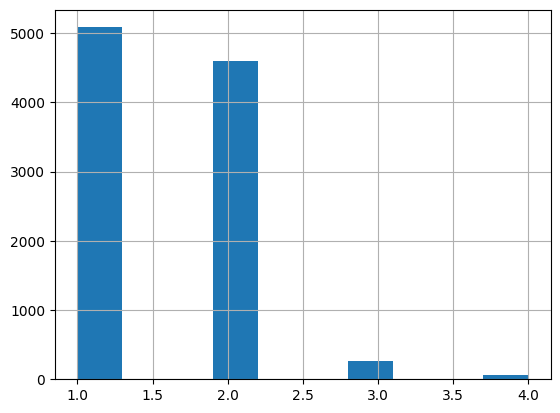

Column: credit_card


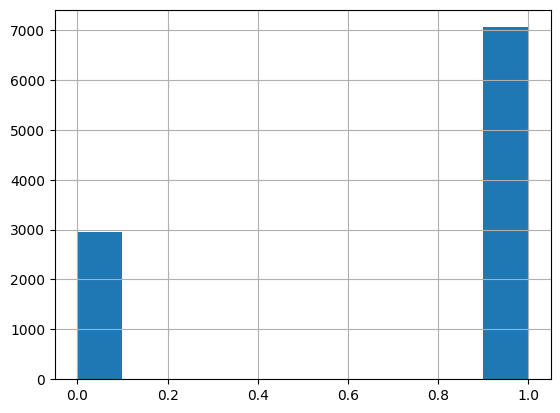

Column: active_member


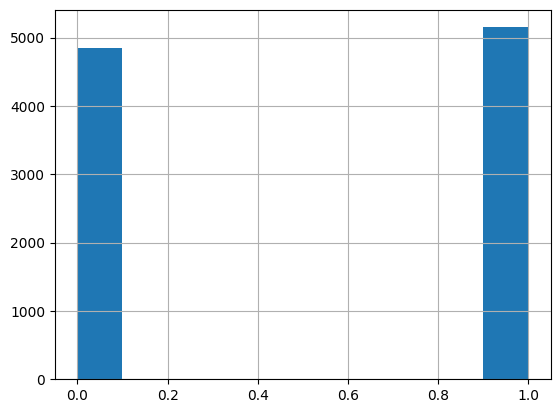

Column: estimated_salary


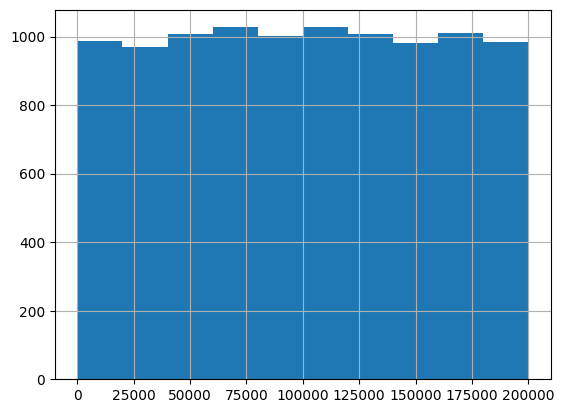

Column: churn


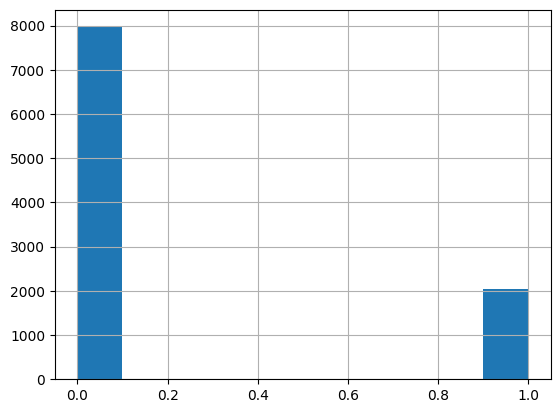

In [15]:
col = df.columns
for i in col:
  print('Column:', i)
  df[i].hist()
  mpl.show()

In [16]:
# col = []
# for k in df.columns:
#   if df[k].dtype == 'int' or df[k].dtype == 'float':
#     col.append(k)
# for j in col:
#   print("column:",j)
#   mpl.boxplot(df[j])
#   mpl.show()

In [17]:
# for k in col:
#   for l in col:
#     sb.scatterplot(x = k,y = l,data = df)
#     mpl.show()

In [18]:
df.describe()

,credit_score,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,650.528800,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,96.653299,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,350.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,584.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,652.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,718.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,850.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


In [19]:
df.head()

,credit_score,gender,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,churn
0,619,Female,42,2,0.00,1,1,1,101348.88,1
1,608,Female,41,1,83807.86,1,0,1,112542.58,0
2,502,Female,42,8,159660.80,3,1,0,113931.57,1
3,699,Female,39,1,0.00,2,0,0,93826.63,0
4,850,Female,43,2,125510.82,1,1,1,79084.10,0


In [20]:
df = pd.get_dummies(df,drop_first=True)

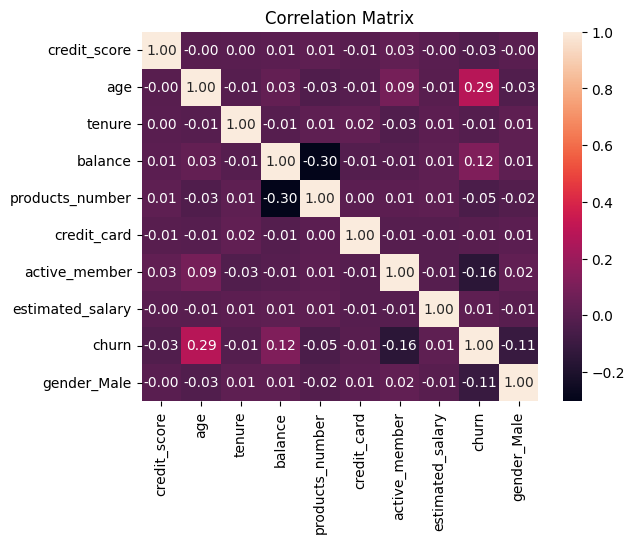

In [21]:
sb.heatmap(df.corr(),annot = True,fmt = '.2f')
mpl.title('Correlation Matrix')
mpl.show()

In [22]:
df.corr()['churn']

credit_score       -0.027094
age                 0.285323
tenure             -0.014001
balance             0.118533
products_number    -0.047820
credit_card        -0.007138
active_member      -0.156128
estimated_salary    0.012097
churn               1.000000
gender_Male        -0.106512
Name: churn, dtype: float64

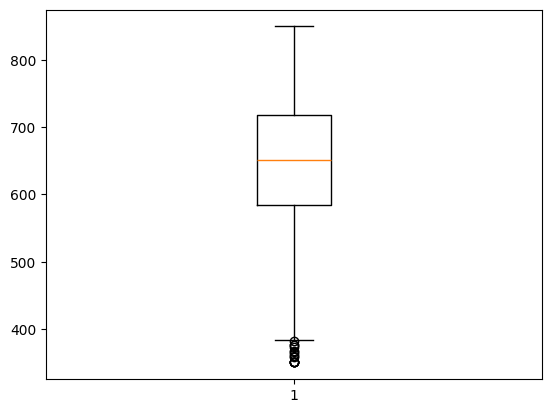

In [23]:
box1 = mpl.boxplot(df['credit_score'])

In [24]:
len([i.get_ydata() for i in box1['fliers']])

1

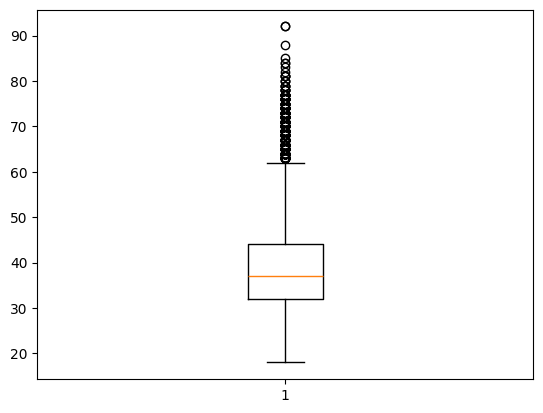

In [25]:
box = mpl.boxplot(df['age'])

In [26]:
len([i.get_ydata() for i in box['fliers']][0])

359

In [27]:
from scipy.stats import zscore

In [28]:
zscore(df['age'])

array([ 0.29351742,  0.19816383,  0.29351742, ..., -0.27860412,
        0.29351742, -1.04143285], shape=(10000,))

In [29]:
df[(zscore(df['age'])>3)|(zscore(df['age'])<-3)]['age']

85      75
158     73
230     72
252     79
310     80
        ..
9646    71
9671    78
9736    78
9894    77
9936    77
Name: age, Length: 133, dtype: int64

In [30]:
X = df.drop('churn',axis = 1)
y = df['churn']

In [31]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,random_state = 42,test_size = 0.3)
X_train.shape,X_test.shape

((7000, 9), (3000, 9))

In [32]:
# from imblearn.combine import SMOTETomek
# sampling = SMOTETomek()
# X_train_os,y_train_os = sampling.fit_resample(X_train,y_train)
# y_train_os.value_counts()

In [33]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler

In [34]:
X_train.head()

,credit_score,age,tenure,balance,products_number,credit_card,active_member,estimated_salary,gender_Male
9069,619,32,4,175406.13,2,1,1,172792.43,False
2603,643,34,7,160426.07,1,0,1,188533.11,False
7738,561,33,6,0.00,2,0,0,173680.39,True
1579,618,41,8,37702.79,1,1,1,195775.48,True
5058,714,37,9,148466.93,2,0,1,151280.96,True


In [ ]:
X_train["estimated_salary"] 

In [33]:
transform = ColumnTransformer(transformers=[
    ('c1',StandardScaler(),['estimated_salary']),
    ('c2',StandardScaler(),['balance']),
    ('c3',RobustScaler(),['credit_score']),
    ('c4',RobustScaler(),['age'])
],remainder = 'passthrough')

In [34]:
X_train_scl = transform.fit_transform(X_train)
X_test_scl = transform.transform(X_test)

NameError: name 'X_train_os' is not defined

## **Logistic Regression**

In [163]:
from sklearn.linear_model import LogisticRegression
lor = LogisticRegression()
lor_model = lor.fit(X_train_scl,y_train_os)
lor_model

LogisticRegression()

In [164]:
lor_y_pred = lor.predict(X_test_scl)
lor_y_pred

array([0, 0, 1, ..., 0, 0, 1])

In [165]:
from sklearn.metrics import confusion_matrix,classification_report,roc_curve,precision_score,recall_score

In [166]:
def CM(Actual,Predicted):
  cm = sb.heatmap(confusion_matrix(Actual,Predicted),annot = True,fmt = '.2f',xticklabels=['yes','No'],yticklabels=['yes','No'])
  mpl.xlabel('Predicted')
  mpl.ylabel('Actual')
  return cm

In [167]:
def ROC_Curve(Actual,Predicted):
  fpr,tpr,thresholds = roc_curve(Actual,Predicted)
  roc = mpl.plot(fpr,tpr)
  mpl.xlabel('False Possitive Rate')
  mpl.ylabel('True Possitive Rate')
  mpl.title('ROC Curve')
  mpl.show()
  return roc

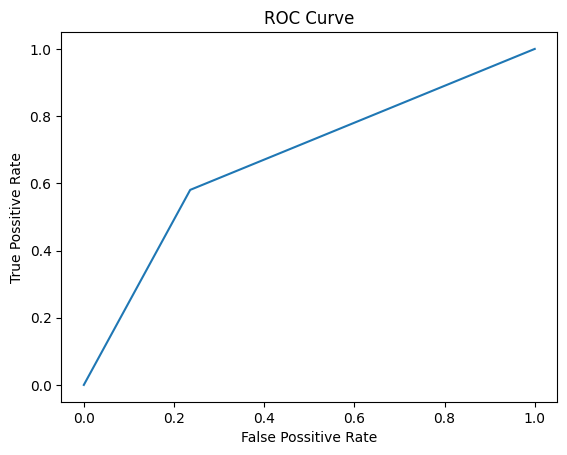

In [168]:
ROC_Curve(y_test,lor_y_pred)

<Axes: xlabel='Predicted', ylabel='Actual'>

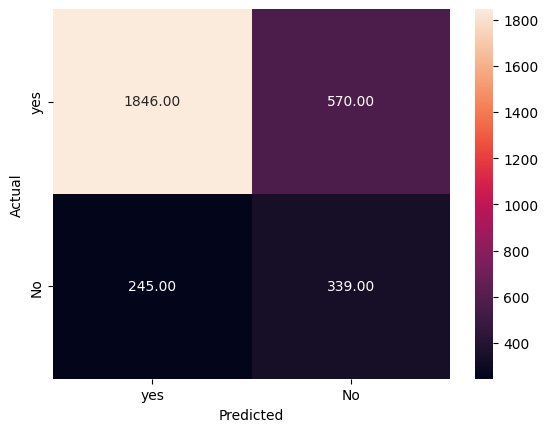

In [169]:
CM(y_test,lor_y_pred)

In [170]:
recall_score(y_test,lor_y_pred)

0.5804794520547946

In [171]:
precision_score(y_test,lor_y_pred)

0.37293729372937295

In [172]:
print(classification_report(y_test,lor_y_pred))

              precision    recall  f1-score   support

           0       0.88      0.76      0.82      2416
           1       0.37      0.58      0.45       584

    accuracy                           0.73      3000
   macro avg       0.63      0.67      0.64      3000
weighted avg       0.78      0.73      0.75      3000



# XAI

In [53]:
!pip install interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 103.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.6/572.6 kB 57.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 16.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 758.0/758.0 kB 72.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 100.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 117.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 120.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 33.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.6/233.6 kB 28.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.0/247.0 kB 27.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 98.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 17.7 MB/s eta

In [54]:
!pip install --upgrade interpret

In [55]:
import interpret

In [56]:
from interpret.glassbox import LogisticRegression,ClassificationTree

In [57]:
from interpret import show

In [58]:
lr = LogisticRegression()
lr.fit(X_train_scl,y_train_os)

In [59]:
lr_exp = lr.explain_local(X_test_scl,y_test)
show(lr_exp)

In [60]:
tree = ClassificationTree()
tree.fit(X_train,y_train)

In [61]:
tree_exp = tree.explain_local(X_test_scl,y_test)
show(tree_exp)

## **Decision Tree**

In [62]:
from sklearn.tree import DecisionTreeClassifier
DecisionTreeClassifier()
dt = DecisionTreeClassifier(criterion = 'entropy',min_samples_split=20,max_depth = 5)
dt_model = dt.fit(X_train,y_train)
dt_model

DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_split=20)

In [63]:
dt_y_pred = dt.predict(X_test)
dt_y_pred

array([0, 0, 0, ..., 0, 0, 0])

<Axes: xlabel='Predicted', ylabel='Actual'>

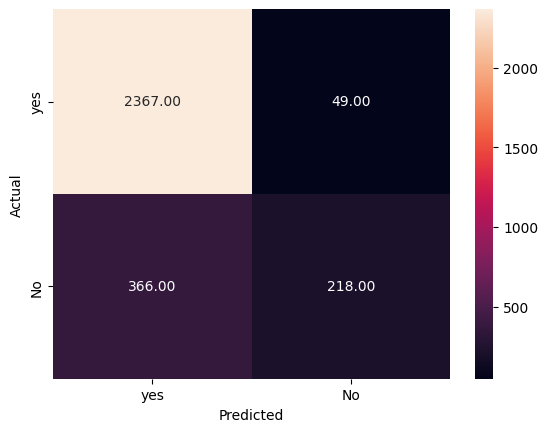

In [64]:
CM(y_test,dt_y_pred)

In [66]:
print(classification_report(y_test,dt_y_pred))

              precision    recall  f1-score   support

           0       0.87      0.98      0.92      2416
           1       0.82      0.37      0.51       584

    accuracy                           0.86      3000
   macro avg       0.84      0.68      0.72      3000
weighted avg       0.86      0.86      0.84      3000



**Hyperparameter Tunning**

In [67]:
from sklearn.model_selection import GridSearchCV
tunning_dt = [{"criterion":['gini','entropy'],'max_depth':range(1,10),'min_samples_split':range(1,30)}]
gs_dt = GridSearchCV(DecisionTreeClassifier(),tunning_dt,scoring = 'accuracy',cv = 10)
gs_dt.fit(X_train,y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(),
             param_grid=[{'criterion': ['gini', 'entropy'],
                          'max_depth': range(1, 10),
                          'min_samples_split': range(1, 30)}],
             scoring='accuracy')

In [68]:
gs_dt.best_params_

{'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 2}

In [69]:
gs_dt.best_score_

0.8522857142857143

# **Random Forest**

In [70]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators = 50,criterion = 'gini',min_samples_split=30)
rf_model = rf.fit(X_train,y_train)
rf_model

RandomForestClassifier(min_samples_split=30, n_estimators=50)

In [71]:
rf_y_pred = rf.predict(X_test)
rf_y_pred

array([0, 0, 0, ..., 0, 0, 0])

<Axes: xlabel='Predicted', ylabel='Actual'>

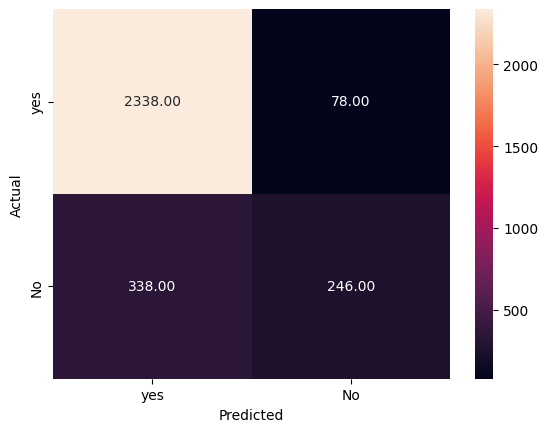

In [72]:
CM(y_test,rf_y_pred)

In [74]:
print(classification_report(y_test,rf_y_pred))

              precision    recall  f1-score   support

           0       0.87      0.97      0.92      2416
           1       0.76      0.42      0.54       584

    accuracy                           0.86      3000
   macro avg       0.82      0.69      0.73      3000
weighted avg       0.85      0.86      0.85      3000



Hyperparameter Tunning

In [75]:
rf_tun = [{'min_samples_split':range(5,20),'n_estimators':range(1,10),'max_depth':[5,10,15]}]
gs_rf = GridSearchCV(RandomForestClassifier(),rf_tun,cv = 10,scoring = 'accuracy')
gs_rf.fit(X_train,y_train)

GridSearchCV(cv=10, estimator=RandomForestClassifier(),
             param_grid=[{'max_depth': [5, 10, 15],
                          'min_samples_split': range(5, 20),
                          'n_estimators': range(1, 10)}],
             scoring='accuracy')

In [76]:
gs_rf.best_params_

{'max_depth': 10, 'min_samples_split': 13, 'n_estimators': 9}

In [77]:
gs_rf.best_score_

0.853

# **Ada Boost**

In [78]:
from sklearn.ensemble import AdaBoostClassifier
abc = AdaBoostClassifier(n_estimators=  100,learning_rate = 0.1)
abc_clf = abc.fit(X_train_scl,y_train_os)

In [79]:
abc_y_pred = abc.predict(X_test)
abc_y_pred

array([0, 0, 0, ..., 0, 0, 0])

<Axes: xlabel='Predicted', ylabel='Actual'>

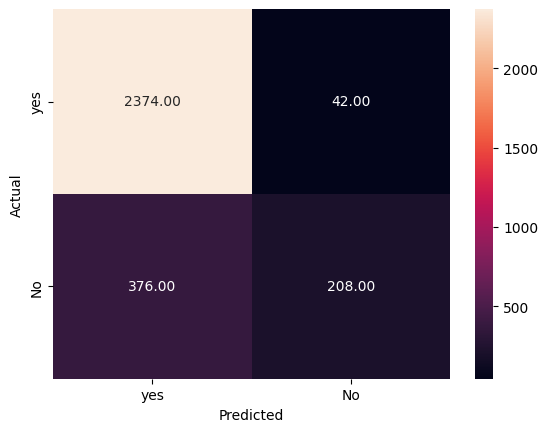

In [80]:
CM(y_test,abc_y_pred)

In [81]:
print(classification_report(y_test,abc_y_pred))

              precision    recall  f1-score   support

           0       0.86      0.98      0.92      2416
           1       0.83      0.36      0.50       584

    accuracy                           0.86      3000
   macro avg       0.85      0.67      0.71      3000
weighted avg       0.86      0.86      0.84      3000



**Hyperparameter tunning**

In [82]:
from sklearn.model_selection import GridSearchCV
abc_gs =AdaBoostClassifier()
Tunning =[{'n_estimators':[100,500],'learning_rate': [0.1,0.001,0.0001,]}]
gs = GridSearchCV(abc_gs,Tunning,scoring='accuracy',cv = 10)
gs.fit(X_train_scl,y_train_os)

GridSearchCV(cv=10, estimator=AdaBoostClassifier(),
             param_grid=[{'learning_rate': [0.1, 0.001, 0.0001],
                          'n_estimators': [100, 500]}],
             scoring='accuracy')

In [83]:
gs.best_params_

{'learning_rate': 0.1, 'n_estimators': 100}

In [84]:
gs.best_score_

0.8505714285714285

In [110]:
from xgboost import XGBClassifier

In [112]:
model_xg = XGBClassifier()
model_xg.fit(X_train_scl,y_train_os)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [113]:
xg_y_pred = model_xg.predict(X_test_scl)
xg_y_pred

array([0, 0, 0, ..., 0, 0, 0])

In [114]:
print(classification_report(y_test,xg_y_pred))

              precision    recall  f1-score   support

           0       0.87      0.95      0.91      2416
           1       0.66      0.43      0.52       584

    accuracy                           0.85      3000
   macro avg       0.77      0.69      0.71      3000
weighted avg       0.83      0.85      0.83      3000



<Axes: xlabel='Predicted', ylabel='Actual'>

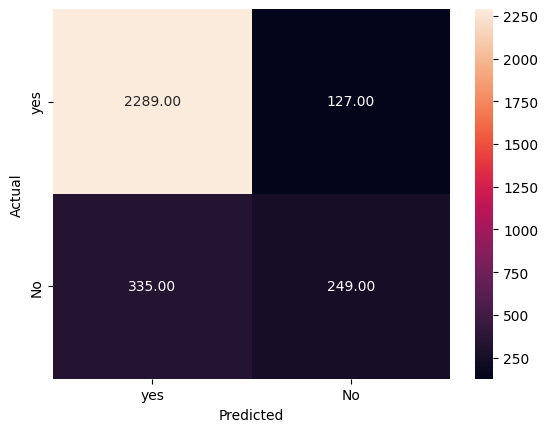

In [116]:
CM(y_test,xg_y_pred)

Hyperparameter Tunning

In [120]:
param_grid = {
    'learning_rate': [0.1,0.2,0.3],
    'max_depth': range(3,7),
    'n_estimators': [100,200,300],
    'subsample': [0.8, 1.0],
}

In [121]:
grid_search = GridSearchCV(estimator=model_xg, param_grid=param_grid, scoring='accuracy', cv=5)
grid_search.fit(X_train_scl,y_train_os)

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     gpu_id=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, predictor=None,
                                     random_state=None, ...),
             param_grid={'learning_rate': [0.1, 0.2, 0.3],
                         'max_depth': range(3, 7),
                         'n_estimators': [100, 200, 300],
                         'subsample': [0.8, 1.0]},
             scoring='accuracy')

In [122]:
grid_search.best_params_

{'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100, 'subsample': 0.8}

In [123]:
grid_search.best_score_

0.8547142857142858

## **SVM**

In [85]:
from sklearn.svm import SVC
SVC = SVC(kernel= "poly")
SVC_cls = SVC.fit(X_train_scl,y_train_os)

In [86]:
svc_y_pred = SVC.predict(X_test_scl)
svc_y_pred

array([0, 0, 0, ..., 0, 0, 0])

<Axes: xlabel='Predicted', ylabel='Actual'>

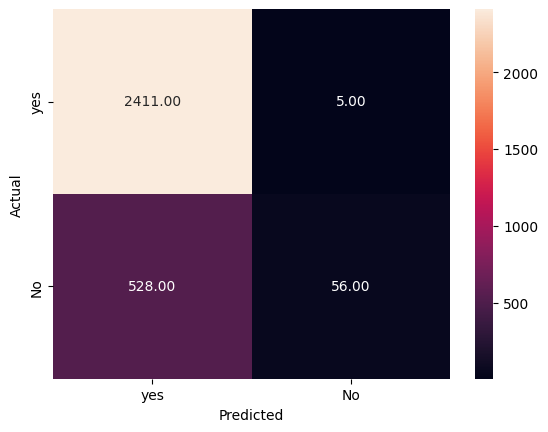

In [87]:
CM(y_test,svc_y_pred)

In [88]:
print(classification_report(y_test,svc_y_pred))

              precision    recall  f1-score   support

           0       0.82      1.00      0.90      2416
           1       0.92      0.10      0.17       584

    accuracy                           0.82      3000
   macro avg       0.87      0.55      0.54      3000
weighted avg       0.84      0.82      0.76      3000



In [89]:
svm_tun = [{"kernel":["poly","sigmoid",'rbf']}]
svm_gs = GridSearchCV(SVC,svm_tun,cv=10,scoring = 'accuracy')
svm_gs.fit(X_train_scl,y_train_os)

GridSearchCV(cv=10, estimator=SVC(kernel='poly'),
             param_grid=[{'kernel': ['poly', 'sigmoid', 'rbf']}],
             scoring='accuracy')

In [90]:
svm_gs.best_params_

{'kernel': 'poly'}

In [91]:
svm_gs.best_score_

0.8071428571428572

## **Neural Network**

In [92]:
import tensorflow
from tensorflow import keras
from keras import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras.callbacks import EarlyStopping

In [93]:
callback = EarlyStopping(
    patience=10,
    monitor = "val_loss",
    min_delta = 0.001,
    verbose = 0,
    mode= "auto"
)

In [94]:
model = Sequential()
model.add(Dense(36,activation = 'relu',input_dim = 9,kernel_initializer = "glorot_normal"))
model.add(Dense(36,activation = 'relu',kernel_initializer = "glorot_normal"))
model.add(Dense(36,activation = 'relu',kernel_initializer = "glorot_normal"))
model.add(Dense(36,activation = 'relu',kernel_initializer = "glorot_normal"))
model.add(Dropout(0.3))
model.add(Dense(1,activation = "sigmoid"))

In [95]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 36)                360       
                                                                 
 dense_1 (Dense)             (None, 36)                1332      
                                                                 
 dense_2 (Dense)             (None, 36)                1332      
                                                                 
 dense_3 (Dense)             (None, 36)                1332      
                                                                 
 dropout (Dropout)           (None, 36)                0         
                                                                 
 dense_4 (Dense)             (None, 1)                 37        
                                                                 
Total params: 4,393
Trainable params: 4,393
Non-trainabl

In [96]:
model.get_weights()[0]

array([[ 3.35459292e-01, -2.37904295e-01,  6.50664866e-02,
        -1.05070934e-01, -3.32809627e-01,  6.77526444e-02,
         2.52547145e-01, -9.24114063e-02, -8.84914622e-02,
        -1.01884574e-01,  5.50766662e-02,  3.56993645e-01,
         2.09585473e-01, -3.41173291e-01, -2.30461106e-01,
         1.13732293e-01, -4.13428545e-02, -2.92893708e-01,
         5.94084244e-03, -2.09823802e-01, -2.79247344e-01,
         5.66028710e-03, -1.80276707e-01, -1.82033584e-01,
         3.17700088e-01, -2.46388927e-01,  2.33698353e-01,
         2.18167692e-01, -1.71311840e-01,  2.37975150e-01,
        -3.11719596e-01,  1.17467400e-02,  1.68754458e-01,
        -2.93421388e-01, -1.84346780e-01, -3.37988943e-01],
       [ 5.17162047e-02,  1.53034464e-01, -2.51787789e-02,
        -4.60513413e-01,  2.95650005e-01,  3.77047472e-02,
         1.29786536e-01, -8.56953189e-02,  3.11468214e-01,
        -4.49063689e-01,  1.70455918e-01,  4.50208515e-01,
         1.12620465e-01, -1.78660825e-01, -9.30636823e-

In [97]:
model.compile(optimizer = "Adam",metrics = 'accuracy',loss = 'binary_crossentropy')
history = model.fit(X_train_scl,y_train,validation_data =(X_test_scl,y_test),
                    epochs = 1000,callbacks = callback,batch_size = 32)

Epoch 1/1000
219/219 [==============================] - 8s 6ms/step - loss: 0.4765 - accuracy: 0.7891 - val_loss: 0.4265 - val_accuracy: 0.8060
Epoch 2/1000
219/219 [==============================] - 1s 5ms/step - loss: 0.4395 - accuracy: 0.8051 - val_loss: 0.4155 - val_accuracy: 0.8197
Epoch 3/1000
219/219 [==============================] - 1s 4ms/step - loss: 0.4197 - accuracy: 0.8236 - val_loss: 0.3908 - val_accuracy: 0.8423
Epoch 4/1000
219/219 [==============================] - 1s 4ms/step - loss: 0.4006 - accuracy: 0.8337 - val_loss: 0.3727 - val_accuracy: 0.8457
Epoch 5/1000
219/219 [==============================] - 1s 5ms/step - loss: 0.3794 - accuracy: 0.8429 - val_loss: 0.3674 - val_accuracy: 0.8477
Epoch 6/1000
219/219 [==============================] - 1s 4ms/step - loss: 0.3695 - accuracy: 0.8479 - val_loss: 0.3583 - val_accuracy: 0.8577
Epoch 7/1000
219/219 [==============================] - 1s 5ms/step - loss: 0.3646 - accuracy: 0.8493 - val_loss: 0.3560 - val_accuracy:

In [98]:
model.get_weights()[0]

array([[ 2.17664599e-01, -1.64165467e-01,  1.35803863e-01,
        -1.41992763e-01, -3.15182209e-01, -3.94688174e-03,
         1.79637954e-01, -6.15602210e-02,  8.65146145e-02,
        -7.02598989e-02,  8.68236721e-02,  2.73707360e-01,
         3.08663212e-02, -1.90919787e-01, -1.42362833e-01,
         5.10742776e-02,  1.01811193e-01, -3.89435947e-01,
         8.11061561e-02, -1.96402356e-01, -1.95483133e-01,
        -5.52436989e-03, -1.49927869e-01, -3.20398599e-01,
         4.18662935e-01, -7.53889829e-02,  2.12792486e-01,
         2.45995075e-01, -1.49364499e-02,  2.50625670e-01,
        -2.91160643e-01, -6.23353235e-02,  1.66874006e-01,
        -2.57384390e-01, -2.77335167e-01, -4.05683964e-01],
       [ 7.42297329e-04,  1.70607880e-01,  1.38158826e-02,
        -4.72528547e-01,  1.60727307e-01,  6.18288741e-02,
         5.26778214e-03, -1.48718700e-01,  3.09281468e-01,
        -5.56394041e-01,  6.98563382e-02,  3.76199275e-01,
         2.47120425e-01, -3.01233516e-03, -1.22152299e-

In [99]:
NN_y_pred = model.predict(X_test_scl)
NN_Y_pred = np.where(NN_y_pred>0.5,1,0)
NN_Y_pred

94/94 [==============================] - 0s 2ms/step


array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]])

<Axes: xlabel='Predicted', ylabel='Actual'>

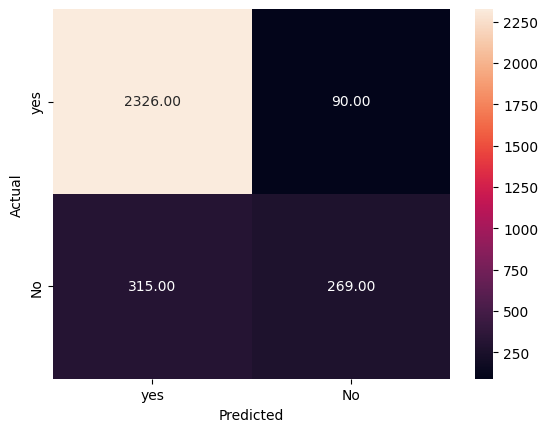

In [100]:
CM(y_test,NN_Y_pred)

In [102]:
print(classification_report(y_test,NN_Y_pred))

              precision    recall  f1-score   support

           0       0.88      0.96      0.92      2416
           1       0.75      0.46      0.57       584

    accuracy                           0.86      3000
   macro avg       0.82      0.71      0.75      3000
weighted avg       0.86      0.86      0.85      3000



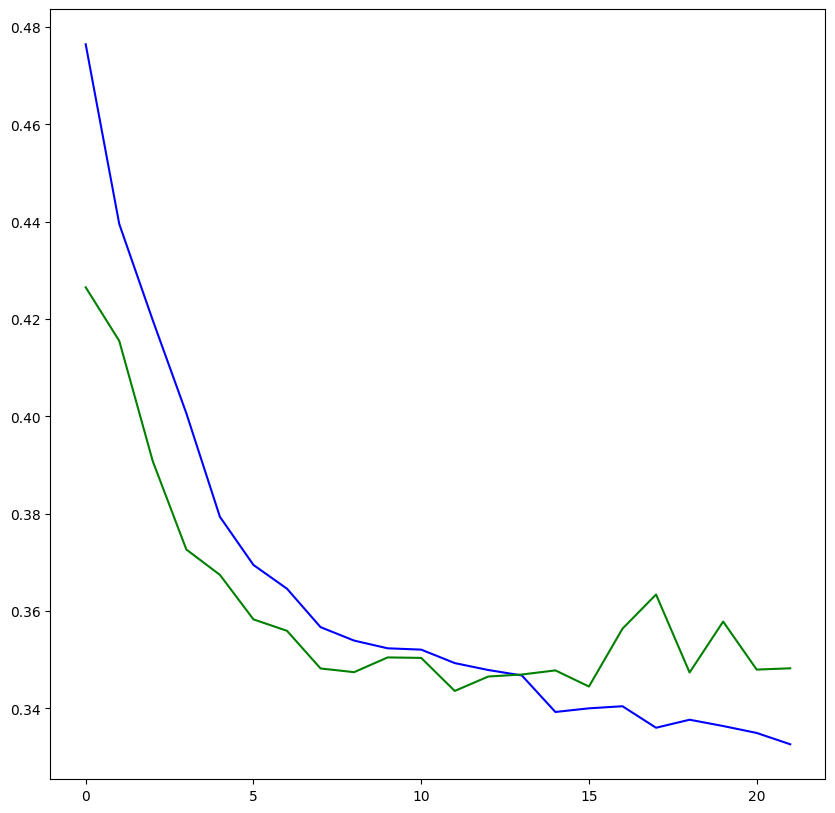

In [103]:
mpl.figure(figsize = (10,10))
mpl.plot(history.history['loss'] ,label='Training Loss',color = 'blue')
mpl.plot(history.history['val_loss'], label='Validation Loss',color = 'green')

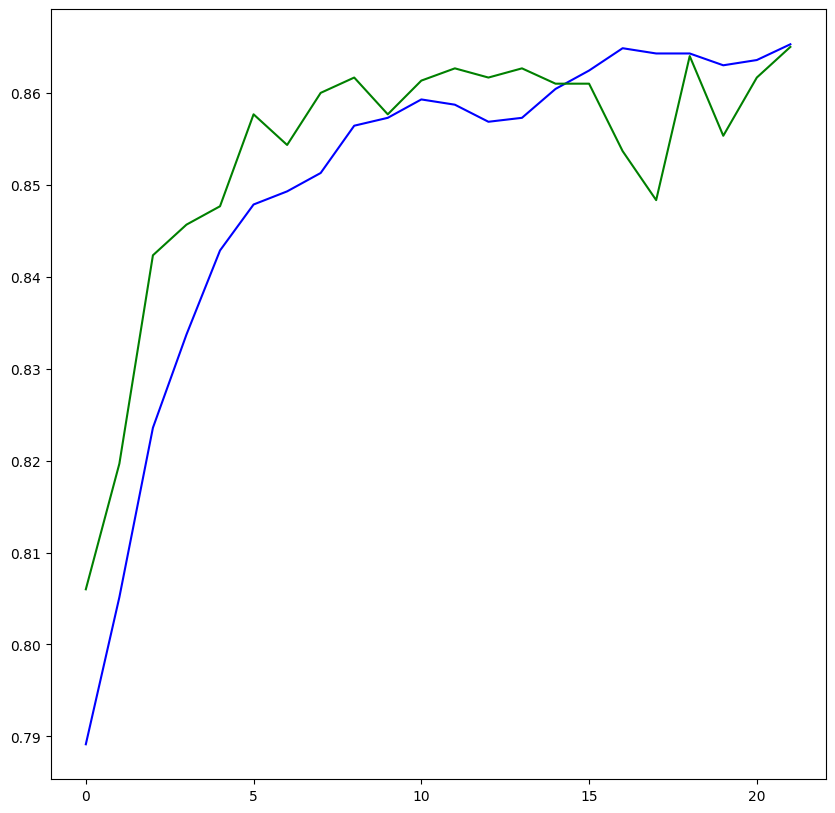

In [104]:
mpl.figure(figsize = (10,10))
mpl.plot(history.history['accuracy'],color = 'blue')
mpl.plot(history.history['val_accuracy'],color = 'green')

# **AUTO ML**

In [105]:
!pip install pycaret

In [106]:
import pycaret
from pycaret.classification import setup

In [107]:
setup(df,target = 'churn')

In [108]:
from pycaret.classification import compare_models
best_model = compare_models()

In [109]:
from pycaret.classification import finalize_model,save_model
final_model = finalize_model(best_model)
save_model(final_model,'final_model')